## 1. Veri Yükleme ve Ön İşleme

In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.metrics import mean_squared_error
from catboost import CatBoostRegressor

# Veri Yükleme
train_path = "C:/Users/ASUS/Desktop/btk datathon - 24/train.csv"
test_path = "C:/Users/ASUS/Desktop/btk datathon - 24/test_x.csv"

In [2]:
df = pd.read_csv(train_path)
test_df = pd.read_csv(test_path)

C:\Users\ASUS\AppData\Local\Temp\ipykernel_24988\2941476830.py:1: DtypeWarning: Columns (13,15,19,30,32,37,41,42) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(train_path)


## 2. Veri Analizi ve Görselleştirme

In [3]:
df

,Basvuru Yili,Degerlendirme Puani,Cinsiyet,Dogum Tarihi,Dogum Yeri,Ikametgah Sehri,Universite Adi,Universite Turu,Burslu ise Burs Yuzdesi,Burs Aliyor mu?,...,Spor Dalindaki Rolunuz Nedir?,Aktif olarak bir STK üyesi misiniz?,Hangi STK'nin Uyesisiniz?,Stk Projesine Katildiniz Mi?,Girisimcilikle Ilgili Deneyiminiz Var Mi?,Girisimcilikle Ilgili Deneyiminizi Aciklayabilir misiniz?,Ingilizce Biliyor musunuz?,Ingilizce Seviyeniz?,"Daha Önceden Mezun Olunduysa, Mezun Olunan Üniversite",id
0,2014,52.0,Erkek,4/6/1994,"Altindag, Ankara",Ankara,İHSAN DOĞRAMACI BİLKENT,Özel,100.0,Evet,...,Diğer,Hayır,NaN,Evet,Hayır,NaN,NaN,NaN,NaN,0
1,2014,30.0,Erkek,6/11/1993,Üsküdar,İstanbul,İHSAN DOĞRAMACI BİLKENT,Özel,100.0,Hayır,...,0,Hayır,NaN,Evet,Evet,Bilkent Cyberparkta bir şirkette Türkiye nin i...,NaN,NaN,NaN,1
2,2014,18.0,Erkek,1/15/1986,Samsun,İstanbul,ULUSLARARASI KIBRIS ÜNİVERSİTESİ,Özel,100.0,Hayır,...,0,Hayır,NaN,Hayır,Hayır,NaN,NaN,NaN,NaN,2
3,2014,40.0,Erkek,6/4/1991,Diyarbakır,İstanbul,İSTANBUL ŞEHİR ÜNİVERSİTESİ,Özel,100.0,Evet,...,0,Hayır,NaN,Evet,Hayır,NaN,NaN,NaN,NaN,3
4,2014,24.0,Erkek,2 Kasim 1992,Ankara/Altındağ,Ankara,TURGUT ÖZAL ÜNİVERSİTESİ,Özel,100.0,Evet,...,0,Hayır,NaN,Hayır,Hayır,NaN,NaN,NaN,NaN,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65120,2022,0.0,Erkek,18.06.2003 00:00,İstanbul,İstanbul,İstanbul Aydın Üniversitesi,Özel,NaN,Evet,...,-,Hayır,-,NaN,Hayır,-,Hayır,NaN,NaN,65120
65121,2022,0.0,Erkek,18.04.2002 00:00,Hatay,Muğla,Muğla Sıtkı Koçman Üniversitesi,Devlet,NaN,Hayır,...,-,Hayır,-,NaN,Hayır,-,Hayır,NaN,NaN,65121
65122,2022,0.0,Erkek,23.10.1999 00:00,Mersin,Mersin,Süleyman Demirel Üniversitesi,Devlet,NaN,Hayır,...,-,Hayır,-,NaN,Hayır,-,Hayır,NaN,NaN,65122
65123,2022,0.0,Erkek,17.11.2000 00:00,Samsun,Samsun,Karabük Üniversitesi,Devlet,NaN,Hayır,...,-,Hayır,-,NaN,Hayır,-,Hayır,NaN,NaN,65123


In [4]:
test_df

,Basvuru Yili,Cinsiyet,Dogum Tarihi,Dogum Yeri,Ikametgah Sehri,Universite Adi,Universite Turu,Burslu ise Burs Yuzdesi,Burs Aliyor mu?,Bölüm,...,Spor Dalindaki Rolunuz Nedir?,Aktif olarak bir STK üyesi misiniz?,Hangi STK'nin Uyesisiniz?,Stk Projesine Katildiniz Mi?,Girisimcilikle Ilgili Deneyiminiz Var Mi?,Girisimcilikle Ilgili Deneyiminizi Aciklayabilir misiniz?,Ingilizce Biliyor musunuz?,Ingilizce Seviyeniz?,"Daha Önceden Mezun Olunduysa, Mezun Olunan Üniversite",id
0,2023,Kadın,21.06.2002 00:00,Amasya,Amasya,Munzur Üniversitesi,Devlet,NaN,Hayır,Sosyal Hizmet,...,Takım Oyuncusu,Evet,Kızılay da gönüllü dağıtım,NaN,Hayır,-,Evet,NaN,NaN,0
1,2023,Kadın,11.05.2004 00:00,Konya,Konya,Hacettepe Üniversitesi,Devlet,NaN,Hayır,Uluslararası İlişkiler,...,Bireysel Spor,Hayır,-,NaN,Hayır,-,Evet,NaN,NaN,1
2,2023,Erkek,24.04.2002 00:00,İstanbul,İstanbul,Kapadokya Üniversitesi,Özel,NaN,Evet,Diğer,...,Bireysel Spor,Hayır,-,NaN,Hayır,-,Evet,NaN,NaN,2
3,2023,Erkek,11.03.2003 00:00,Mardin,Mardin,Mardin Artuklu Üniversitesi,Devlet,NaN,Hayır,İslami İlimler,...,-,Evet,Lise gezilerde liderlik yapıyordum,NaN,Hayır,-,Hayır,NaN,NaN,3
4,2023,Erkek,26.01.2002 00:00,Samsun,İstanbul,Boğaziçi Üniversitesi,Devlet,NaN,Hayır,İşletme,...,-,Evet,"Toplum Gönüllüleri Vakfı'nda ""Yol Arkadaşım"" P...",NaN,Evet,"12 aydır, yolculuğuna bir yıl önce başlamış ol...",Evet,NaN,NaN,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11044,2023,Kadın,3.01.2002 00:00,Yozgat,Ankara,Gazi Üniversitesi,Devlet,NaN,Hayır,Endüstri Mühendisliği,...,-,Evet,TOG Vakfı'nda yaklaşık bir yıldır hem aktif gö...,NaN,Hayır,-,Evet,NaN,NaN,11044
11045,2023,Kadın,9.09.2001 00:00,Konya,Konya,Niğde Ömer Halisdemir Üniversitesi,Devlet,NaN,Hayır,Gıda Mühendisliği,...,-,Evet,Konyada düzenlenen 5. İslami dayanışma oyunlar...,NaN,Hayır,-,Hayır,NaN,NaN,11045
11046,2023,Erkek,8.06.2004 00:00,Ankara,Ankara,Karabük Üniversitesi,Devlet,NaN,Hayır,Elektrik-Elektronik Mühendisliği,...,Takım Oyuncusu,Evet,Hayvanlara yardım adı altında hayvanlara yardı...,NaN,Hayır,-,Evet,NaN,NaN,11046
11047,2023,Kadın,16.10.2001 00:00,Adıyaman,İstanbul,Bursa Uludağ Üniversitesi,Devlet,NaN,Hayır,"Moleküler Biyoloji, Genetik ve Biyomühendislik",...,Bireysel Spor,Evet,"Ağaç dikme, huzur evi ziyareti",NaN,Evet,Eğitim olarak deneyimim var. Aynı zamanda “Asp...,Evet,NaN,NaN,11047


**Veri Anlizi Ve Görselleştirme**

In [5]:
import matplotlib.pyplot as plt
import seaborn as sns

In [6]:
df.head(10)

,Basvuru Yili,Degerlendirme Puani,Cinsiyet,Dogum Tarihi,Dogum Yeri,Ikametgah Sehri,Universite Adi,Universite Turu,Burslu ise Burs Yuzdesi,Burs Aliyor mu?,...,Spor Dalindaki Rolunuz Nedir?,Aktif olarak bir STK üyesi misiniz?,Hangi STK'nin Uyesisiniz?,Stk Projesine Katildiniz Mi?,Girisimcilikle Ilgili Deneyiminiz Var Mi?,Girisimcilikle Ilgili Deneyiminizi Aciklayabilir misiniz?,Ingilizce Biliyor musunuz?,Ingilizce Seviyeniz?,"Daha Önceden Mezun Olunduysa, Mezun Olunan Üniversite",id
0,2014,52.0,Erkek,4/6/1994,"Altindag, Ankara",Ankara,İHSAN DOĞRAMACI BİLKENT,Özel,100.0,Evet,...,Diğer,Hayır,NaN,Evet,Hayır,NaN,NaN,NaN,NaN,0
1,2014,30.0,Erkek,6/11/1993,Üsküdar,İstanbul,İHSAN DOĞRAMACI BİLKENT,Özel,100.0,Hayır,...,0,Hayır,NaN,Evet,Evet,Bilkent Cyberparkta bir şirkette Türkiye nin i...,NaN,NaN,NaN,1
2,2014,18.0,Erkek,1/15/1986,Samsun,İstanbul,ULUSLARARASI KIBRIS ÜNİVERSİTESİ,Özel,100.0,Hayır,...,0,Hayır,NaN,Hayır,Hayır,NaN,NaN,NaN,NaN,2
3,2014,40.0,Erkek,6/4/1991,Diyarbakır,İstanbul,İSTANBUL ŞEHİR ÜNİVERSİTESİ,Özel,100.0,Evet,...,0,Hayır,NaN,Evet,Hayır,NaN,NaN,NaN,NaN,3
4,2014,24.0,Erkek,2 Kasim 1992,Ankara/Altındağ,Ankara,TURGUT ÖZAL ÜNİVERSİTESİ,Özel,100.0,Evet,...,0,Hayır,NaN,Hayır,Hayır,NaN,NaN,NaN,NaN,4
5,2014,37.0,Erkek,4/14/1992,İSTANBUL,İstanbul,İSTANBUL TİCARET ÜNİVERSİTESİ,Özel,100.0,Evet,...,0,Hayır,NaN,Hayır,Hayır,NaN,NaN,NaN,NaN,5
6,2014,18.0,Erkek,10/13/1994,İstanbul,İstanbul,İSTANBUL MEDİPOL ÜNİVERSİTESİ,Özel,100.0,Hayır,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6
7,2014,24.0,Erkek,3/18/1993,İstanbul,İstanbul,FATİH SULTAN MEHMET VAKIF,Özel,100.0,Evet,...,0,Hayır,NaN,Evet,Hayır,NaN,NaN,NaN,NaN,7
8,2014,40.0,Erkek,29 Aralik 1991,Erzincan- Refahiye,Esenler/İstanbul,BAHÇEŞEHİR ÜNİVERSİTESİ,Özel,100.0,Evet,...,0,Evet,Demokratikleşme çabaları,Evet,Evet,Konvansiyonel medyanın dönüşümüne ve tüketimin...,NaN,NaN,NaN,8
9,2014,31.0,Erkek,4/25/1991,Sivas,İstanbul,İSTANBUL TİCARET ÜNİVERSİTESİ,Özel,100.0,Evet,...,Diğer,Hayır,NaN,Hayır,Hayır,NaN,NaN,NaN,NaN,9


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 65125 entries, 0 to 65124
Data columns (total 44 columns):
 #   Column                                                     Non-Null Count  Dtype  
---  ------                                                     --------------  -----  
 0   Basvuru Yili                                               65125 non-null  int64  
 1   Degerlendirme Puani                                        65124 non-null  float64
 2   Cinsiyet                                                   64956 non-null  object 
 3   Dogum Tarihi                                               64948 non-null  object 
 4   Dogum Yeri                                                 64334 non-null  object 
 5   Ikametgah Sehri                                            63088 non-null  object 
 6   Universite Adi                                             64993 non-null  object 
 7   Universite Turu                                            64870 non-null  object 
 8   Burslu

In [8]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Basvuru Yili,65125.0,2018.277298,2.669979,2014.0,2016.0,2019.0,2021.0,2022.0
Degerlendirme Puani,65124.0,32.086466,18.139239,0.0,18.0,29.0,44.0,102.0
Burslu ise Burs Yuzdesi,22440.0,34.226181,41.632412,0.0,0.0,0.0,75.0,100.0
id,65125.0,32562.000000,18800.112478,0.0,16281.0,32562.0,48843.0,65124.0


In [9]:
df.isnull().sum()

Basvuru Yili                                                     0
Degerlendirme Puani                                              1
Cinsiyet                                                       169
Dogum Tarihi                                                   177
Dogum Yeri                                                     791
Ikametgah Sehri                                               2037
Universite Adi                                                 132
Universite Turu                                                255
Burslu ise Burs Yuzdesi                                      42685
Burs Aliyor mu?                                                  0
Bölüm                                                          231
Universite Kacinci Sinif                                       374
Universite Not Ortalamasi                                     2753
Daha Once Baska Bir Universiteden Mezun Olmus                37345
Lise Adi                                                      

In [10]:
df.columns

Index(['Basvuru Yili', 'Degerlendirme Puani', 'Cinsiyet', 'Dogum Tarihi',
       'Dogum Yeri', 'Ikametgah Sehri', 'Universite Adi', 'Universite Turu',
       'Burslu ise Burs Yuzdesi', 'Burs Aliyor mu?', 'Bölüm',
       'Universite Kacinci Sinif', 'Universite Not Ortalamasi',
       'Daha Once Baska Bir Universiteden Mezun Olmus', 'Lise Adi',
       'Lise Adi Diger', 'Lise Sehir', 'Lise Turu', 'Lise Bolumu',
       'Lise Bolum Diger', 'Lise Mezuniyet Notu',
       'Baska Bir Kurumdan Burs Aliyor mu?', 'Burs Aldigi Baska Kurum',
       'Baska Kurumdan Aldigi Burs Miktari', 'Anne Egitim Durumu',
       'Anne Calisma Durumu', 'Anne Sektor', 'Baba Egitim Durumu',
       'Baba Calisma Durumu', 'Baba Sektor', 'Kardes Sayisi',
       'Girisimcilik Kulupleri Tarzi Bir Kulube Uye misiniz?',
       'Uye Oldugunuz Kulubun Ismi',
       'Profesyonel Bir Spor Daliyla Mesgul musunuz?',
       'Spor Dalindaki Rolunuz Nedir?', 'Aktif olarak bir STK üyesi misiniz?',
       'Hangi STK'nin Uyesisiniz?', 

---------------------

In [11]:
test_df

,Basvuru Yili,Cinsiyet,Dogum Tarihi,Dogum Yeri,Ikametgah Sehri,Universite Adi,Universite Turu,Burslu ise Burs Yuzdesi,Burs Aliyor mu?,Bölüm,...,Spor Dalindaki Rolunuz Nedir?,Aktif olarak bir STK üyesi misiniz?,Hangi STK'nin Uyesisiniz?,Stk Projesine Katildiniz Mi?,Girisimcilikle Ilgili Deneyiminiz Var Mi?,Girisimcilikle Ilgili Deneyiminizi Aciklayabilir misiniz?,Ingilizce Biliyor musunuz?,Ingilizce Seviyeniz?,"Daha Önceden Mezun Olunduysa, Mezun Olunan Üniversite",id
0,2023,Kadın,21.06.2002 00:00,Amasya,Amasya,Munzur Üniversitesi,Devlet,NaN,Hayır,Sosyal Hizmet,...,Takım Oyuncusu,Evet,Kızılay da gönüllü dağıtım,NaN,Hayır,-,Evet,NaN,NaN,0
1,2023,Kadın,11.05.2004 00:00,Konya,Konya,Hacettepe Üniversitesi,Devlet,NaN,Hayır,Uluslararası İlişkiler,...,Bireysel Spor,Hayır,-,NaN,Hayır,-,Evet,NaN,NaN,1
2,2023,Erkek,24.04.2002 00:00,İstanbul,İstanbul,Kapadokya Üniversitesi,Özel,NaN,Evet,Diğer,...,Bireysel Spor,Hayır,-,NaN,Hayır,-,Evet,NaN,NaN,2
3,2023,Erkek,11.03.2003 00:00,Mardin,Mardin,Mardin Artuklu Üniversitesi,Devlet,NaN,Hayır,İslami İlimler,...,-,Evet,Lise gezilerde liderlik yapıyordum,NaN,Hayır,-,Hayır,NaN,NaN,3
4,2023,Erkek,26.01.2002 00:00,Samsun,İstanbul,Boğaziçi Üniversitesi,Devlet,NaN,Hayır,İşletme,...,-,Evet,"Toplum Gönüllüleri Vakfı'nda ""Yol Arkadaşım"" P...",NaN,Evet,"12 aydır, yolculuğuna bir yıl önce başlamış ol...",Evet,NaN,NaN,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11044,2023,Kadın,3.01.2002 00:00,Yozgat,Ankara,Gazi Üniversitesi,Devlet,NaN,Hayır,Endüstri Mühendisliği,...,-,Evet,TOG Vakfı'nda yaklaşık bir yıldır hem aktif gö...,NaN,Hayır,-,Evet,NaN,NaN,11044
11045,2023,Kadın,9.09.2001 00:00,Konya,Konya,Niğde Ömer Halisdemir Üniversitesi,Devlet,NaN,Hayır,Gıda Mühendisliği,...,-,Evet,Konyada düzenlenen 5. İslami dayanışma oyunlar...,NaN,Hayır,-,Hayır,NaN,NaN,11045
11046,2023,Erkek,8.06.2004 00:00,Ankara,Ankara,Karabük Üniversitesi,Devlet,NaN,Hayır,Elektrik-Elektronik Mühendisliği,...,Takım Oyuncusu,Evet,Hayvanlara yardım adı altında hayvanlara yardı...,NaN,Hayır,-,Evet,NaN,NaN,11046
11047,2023,Kadın,16.10.2001 00:00,Adıyaman,İstanbul,Bursa Uludağ Üniversitesi,Devlet,NaN,Hayır,"Moleküler Biyoloji, Genetik ve Biyomühendislik",...,Bireysel Spor,Evet,"Ağaç dikme, huzur evi ziyareti",NaN,Evet,Eğitim olarak deneyimim var. Aynı zamanda “Asp...,Evet,NaN,NaN,11047


In [12]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11049 entries, 0 to 11048
Data columns (total 43 columns):
 #   Column                                                     Non-Null Count  Dtype  
---  ------                                                     --------------  -----  
 0   Basvuru Yili                                               11049 non-null  int64  
 1   Cinsiyet                                                   11049 non-null  object 
 2   Dogum Tarihi                                               11049 non-null  object 
 3   Dogum Yeri                                                 11049 non-null  object 
 4   Ikametgah Sehri                                            11049 non-null  object 
 5   Universite Adi                                             11049 non-null  object 
 6   Universite Turu                                            11049 non-null  object 
 7   Burslu ise Burs Yuzdesi                                    0 non-null      float64
 8   Burs A

In [13]:
test_df.describe().T

,count,mean,std,min,25%,50%,75%,max
Basvuru Yili,11049.0,2023.000000,0.000000,2023.0,2023.0,2023.0,2023.0,2023.0
Burslu ise Burs Yuzdesi,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Daha Once Baska Bir Universiteden Mezun Olmus,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Lise Adi Diger,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Lise Bolum Diger,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Kardes Sayisi,11049.0,2.118563,1.256795,0.0,1.0,2.0,3.0,4.0
Uye Oldugunuz Kulubun Ismi,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Stk Projesine Katildiniz Mi?,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Ingilizce Seviyeniz?,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"Daha Önceden Mezun Olunduysa, Mezun Olunan Üniversite",0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [14]:
test_df.isnull().sum()

Basvuru Yili                                                     0
Cinsiyet                                                         0
Dogum Tarihi                                                     0
Dogum Yeri                                                       0
Ikametgah Sehri                                                  0
Universite Adi                                                   0
Universite Turu                                                  0
Burslu ise Burs Yuzdesi                                      11049
Burs Aliyor mu?                                                  0
Bölüm                                                            0
Universite Kacinci Sinif                                         0
Universite Not Ortalamasi                                        0
Daha Once Baska Bir Universiteden Mezun Olmus                11049
Lise Adi                                                         0
Lise Adi Diger                                               1

In [15]:
test_df.columns

Index(['Basvuru Yili', 'Cinsiyet', 'Dogum Tarihi', 'Dogum Yeri',
       'Ikametgah Sehri', 'Universite Adi', 'Universite Turu',
       'Burslu ise Burs Yuzdesi', 'Burs Aliyor mu?', 'Bölüm',
       'Universite Kacinci Sinif', 'Universite Not Ortalamasi',
       'Daha Once Baska Bir Universiteden Mezun Olmus', 'Lise Adi',
       'Lise Adi Diger', 'Lise Sehir', 'Lise Turu', 'Lise Bolumu',
       'Lise Bolum Diger', 'Lise Mezuniyet Notu',
       'Baska Bir Kurumdan Burs Aliyor mu?', 'Burs Aldigi Baska Kurum',
       'Baska Kurumdan Aldigi Burs Miktari', 'Anne Egitim Durumu',
       'Anne Calisma Durumu', 'Anne Sektor', 'Baba Egitim Durumu',
       'Baba Calisma Durumu', 'Baba Sektor', 'Kardes Sayisi',
       'Girisimcilik Kulupleri Tarzi Bir Kulube Uye misiniz?',
       'Uye Oldugunuz Kulubun Ismi',
       'Profesyonel Bir Spor Daliyla Mesgul musunuz?',
       'Spor Dalindaki Rolunuz Nedir?', 'Aktif olarak bir STK üyesi misiniz?',
       'Hangi STK'nin Uyesisiniz?', 'Stk Projesine Katildin

------------------

In [30]:
# Veri türlerini ayarlama
categorical_columns = df.select_dtypes(include = ["object"]).columns
numerical_columns = df.select_dtypes(include = ["number"]).columns

df[categorical_columns] = df[categorical_columns].astype(str)
df[numerical_columns] = df[numerical_columns].apply(pd.to_numeric, errors = "coerce")

# apply(pd.to_numeric, errors='coerce') metodu, bu sütunlardaki verileri sayısal veri türüne dönüştürür.
# errors='coerce' seçeneği, dönüştürülemeyen değerleri NaN (eksik değer) olarak işaretler.

In [31]:
categorical_columns

Index(['Cinsiyet', 'Dogum Tarihi', 'Dogum Yeri', 'Ikametgah Sehri',
       'Universite Adi', 'Universite Turu', 'Burs Aliyor mu?', 'Bölüm',
       'Universite Kacinci Sinif', 'Universite Not Ortalamasi',
       'Daha Once Baska Bir Universiteden Mezun Olmus', 'Lise Adi',
       'Lise Adi Diger', 'Lise Sehir', 'Lise Turu', 'Lise Bolumu',
       'Lise Bolum Diger', 'Lise Mezuniyet Notu',
       'Baska Bir Kurumdan Burs Aliyor mu?', 'Burs Aldigi Baska Kurum',
       'Baska Kurumdan Aldigi Burs Miktari', 'Anne Egitim Durumu',
       'Anne Calisma Durumu', 'Anne Sektor', 'Baba Egitim Durumu',
       'Baba Calisma Durumu', 'Baba Sektor', 'Kardes Sayisi',
       'Girisimcilik Kulupleri Tarzi Bir Kulube Uye misiniz?',
       'Uye Oldugunuz Kulubun Ismi',
       'Profesyonel Bir Spor Daliyla Mesgul musunuz?',
       'Spor Dalindaki Rolunuz Nedir?', 'Aktif olarak bir STK üyesi misiniz?',
       'Hangi STK'nin Uyesisiniz?', 'Stk Projesine Katildiniz Mi?',
       'Girisimcilikle Ilgili Deneyiminiz

In [32]:
numerical_columns

Index(['Basvuru Yili', 'Degerlendirme Puani', 'Burslu ise Burs Yuzdesi', 'id'], dtype='object')

In [33]:
# Eksik verilerin işlenmesi

df["Degerlendirme Puani"].fillna(df["Degerlendirme Puani"].mean(), inplace = True)
df["Cinsiyet"].fillna("Bilinmiyor", inplace = True)
df.fillna(df.mode().iloc[0], inplace = True)

Tabii! Bu kod parçası, DataFrame'deki eksik verileri (NaN değerlerini) işlemek için çeşitli yöntemler kullanır. İşte her bir satırın açıklaması:

1. **Belirli Bir Sütundaki Eksik Verilerin Ortalama ile Doldurulması:**
   ```python
   df['Degerlendirme Puani'].fillna(df['Degerlendirme Puani'].mean(), inplace=True)
   ```
   - `df['Degerlendirme Puani']` ifadesi, "Degerlendirme Puani" sütununu seçer.
   - `fillna(df['Degerlendirme Puani'].mean(), inplace=True)` metodu, bu sütundaki eksik verileri sütunun ortalaması ile doldurur.
     - `df['Degerlendirme Puani'].mean()` ifadesi, "Degerlendirme Puani" sütununun ortalamasını hesaplar.
     - `inplace=True` seçeneği, değişiklikleri DataFrame üzerinde doğrudan yapar, yani yeni bir DataFrame oluşturmaz, mevcut DataFrame'i değiştirir.

2. **Belirli Bir Kategorik Sütundaki Eksik Verilerin Sabit Bir Değer ile Doldurulması:**
   ```python
   df['Cinsiyet'].fillna('Bilinmiyor', inplace=True)
   ```
   - `df['Cinsiyet']` ifadesi, "Cinsiyet" sütununu seçer.
   - `fillna('Bilinmiyor', inplace=True)` metodu, bu sütundaki eksik verileri 'Bilinmiyor' değeri ile doldurur.
     - Bu yöntem, kategorik veri içeren sütunlardaki eksik veriler için yaygın bir uygulamadır.

3. **Tüm Diğer Eksik Verilerin Mod (En Sık Tekrar Eden Değer) ile Doldurulması:**
   ```python
   df.fillna(df.mode().iloc[0], inplace=True)
   ```
   - `df.mode()` ifadesi, DataFrame'deki her sütun için en sık tekrar eden değeri (mod) hesaplar.
   - `iloc[0]` ifadesi, modların ilk satırını seçer. Modlar birden fazla satır içerebileceğinden, ilk satır en yaygın modları temsil eder.
   - `fillna(df.mode().iloc[0], inplace=True)` metodu, DataFrame'deki tüm eksik verileri hesaplanan modlar ile doldurur.
     - Bu işlem, hem sayısal hem de kategorik sütunlar için geçerlidir.

Bu kod, eksik verileri mantıklı ve etkili bir şekilde doldurarak veri analizi ve modelleme süreçlerinin doğruluğunu artırmayı amaçlar.

In [34]:
df.isnull().sum()

Basvuru Yili                                                 0
Degerlendirme Puani                                          0
Cinsiyet                                                     0
Dogum Tarihi                                                 0
Dogum Yeri                                                   0
Ikametgah Sehri                                              0
Universite Adi                                               0
Universite Turu                                              0
Burslu ise Burs Yuzdesi                                      0
Burs Aliyor mu?                                              0
Bölüm                                                        0
Universite Kacinci Sinif                                     0
Universite Not Ortalamasi                                    0
Daha Once Baska Bir Universiteden Mezun Olmus                0
Lise Adi                                                     0
Lise Adi Diger                                         

In [35]:
# Kategorik değişkenlerin dağılımını göster
for col in categorical_columns:
    print(df[col].value_counts())

Cinsiyet
Kadın                    32077
Erkek                    22752
ERKEK                    10012
nan                        169
Belirtmek istemiyorum      115
Name: count, dtype: int64
Dogum Tarihi
1/1/70 2:00         1655
1/1/00 0:00          179
nan                  177
1/1/01 0:00          154
1/1/1997             139
                    ... 
29/08/2000             1
7/30/1991              1
14/05/1996             1
15/12/1997             1
12.11.2003 00:00       1
Name: count, Length: 13499, dtype: int64
Dogum Yeri
İstanbul             8682
Ankara               4045
İzmir                2170
Istanbul             1894
Adana                1810
                     ... 
körfez/kocaeli          1
GEDIZ                   1
İstanbul Bakırköy       1
İstanbul-Şişli          1
Ankara keçiören         1
Name: count, Length: 2231, dtype: int64
Ikametgah Sehri
İstanbul               16625
Ankara                  6485
Istanbul                3469
İzmir                   3096
nan         

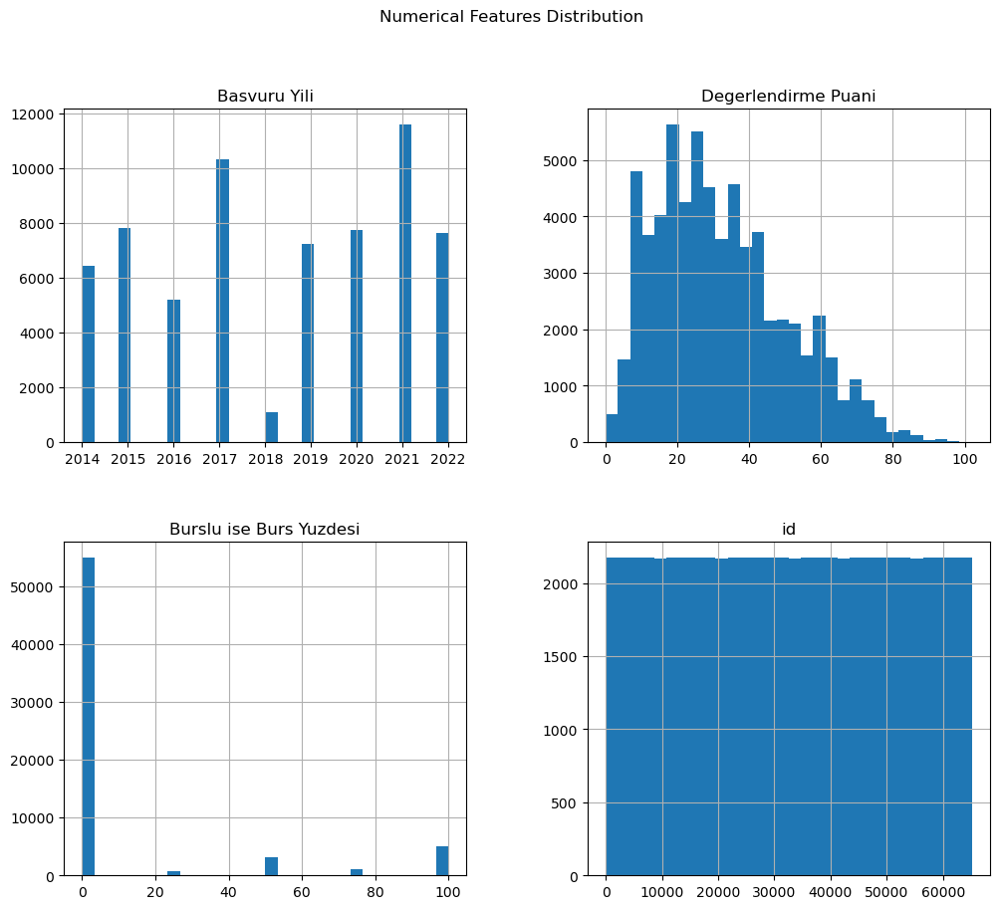

In [36]:
# Sayısal değişkenlerin dağılımını görselleştir

df[numerical_columns].hist(figsize=(12,10), bins = 30)
plt.suptitle('Numerical Features Distribution')
plt.show()

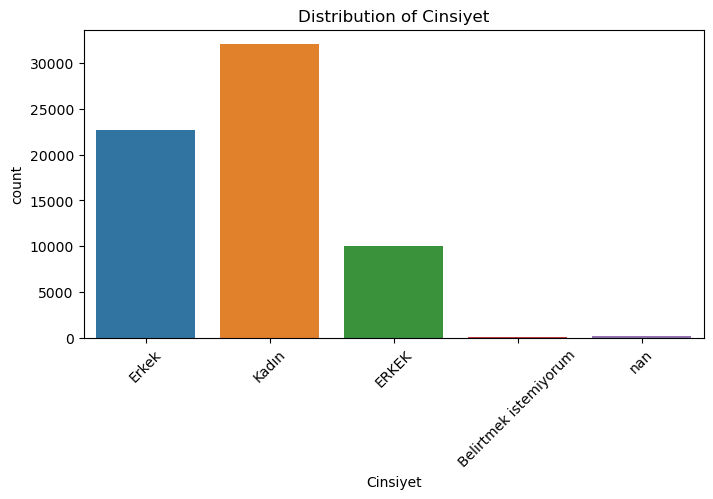

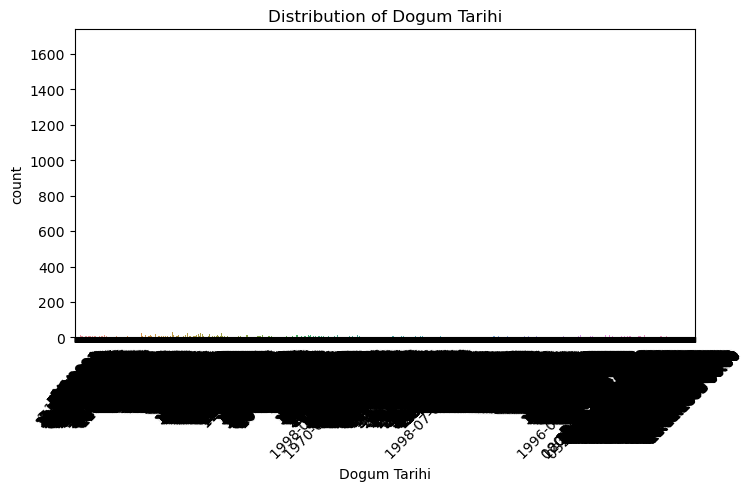

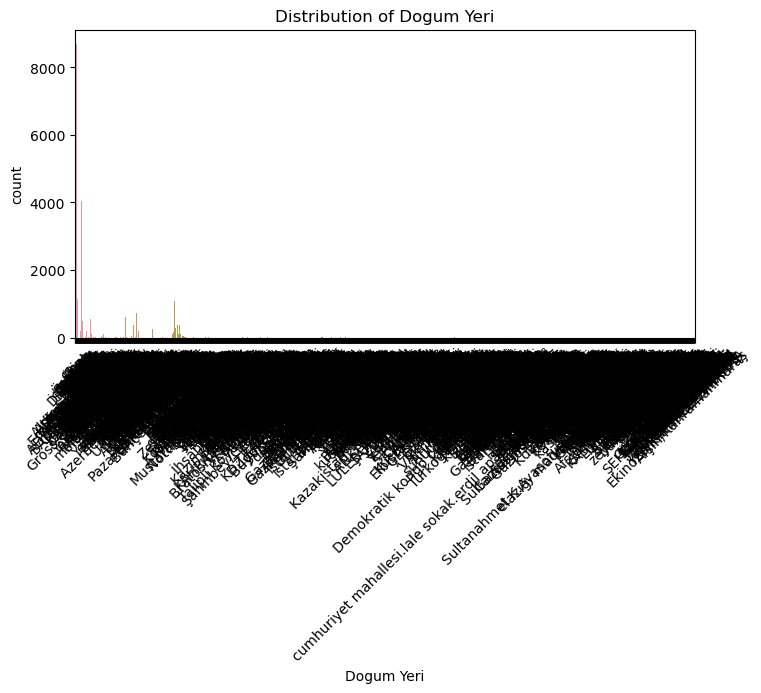

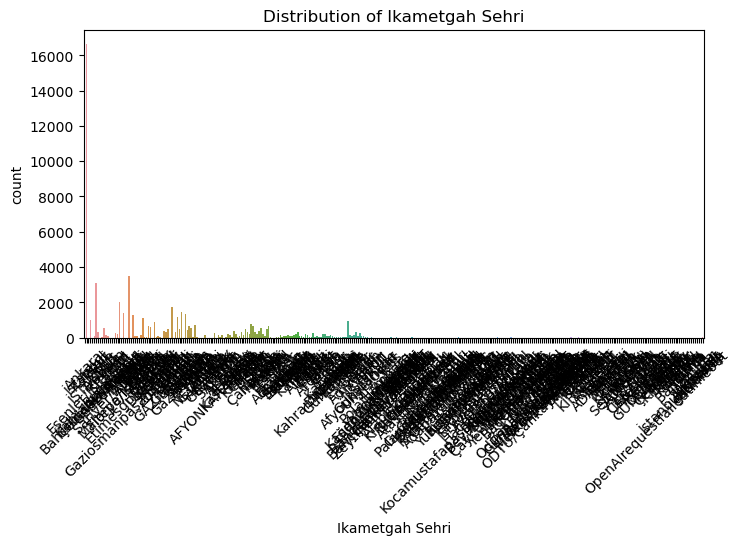

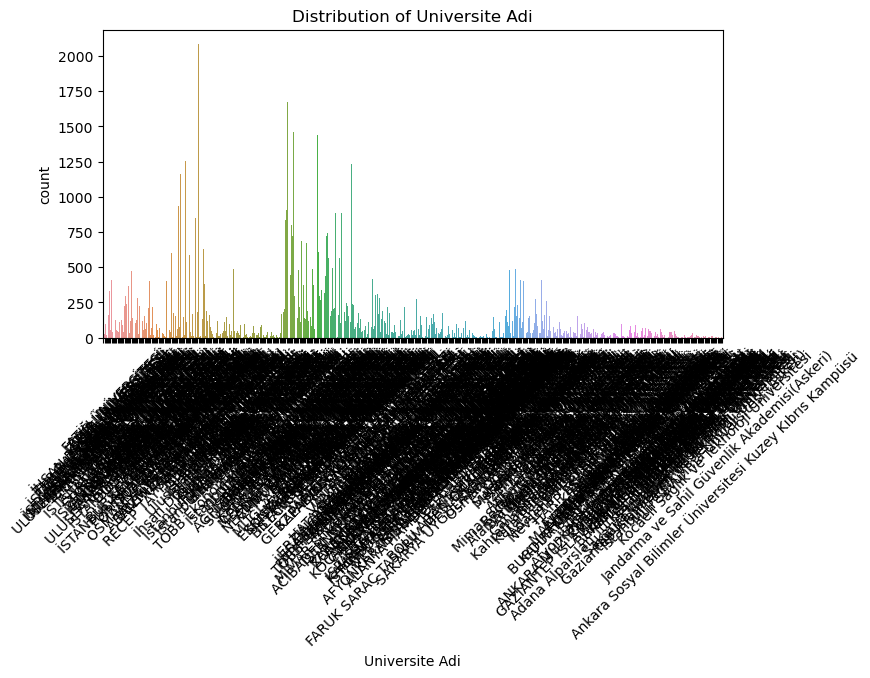

...

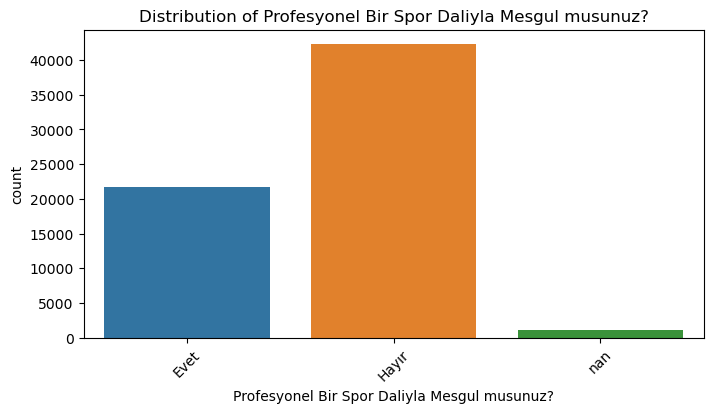

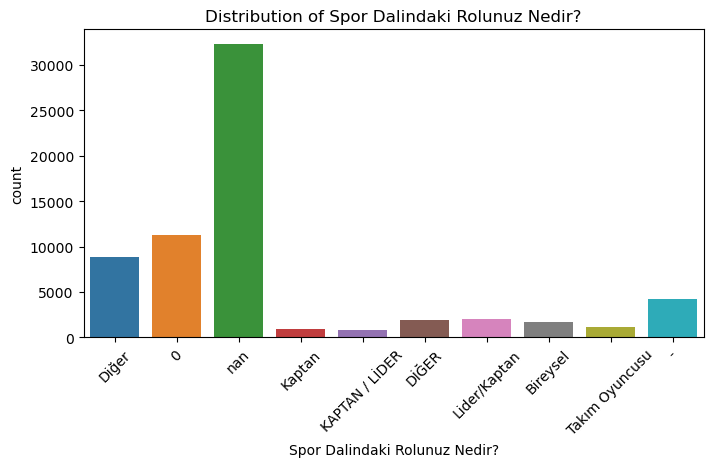

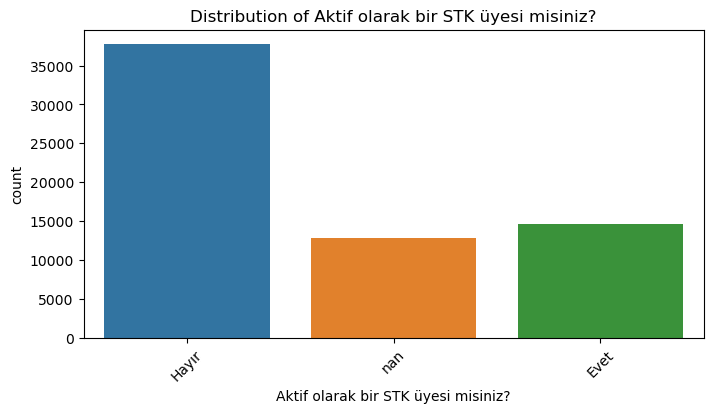

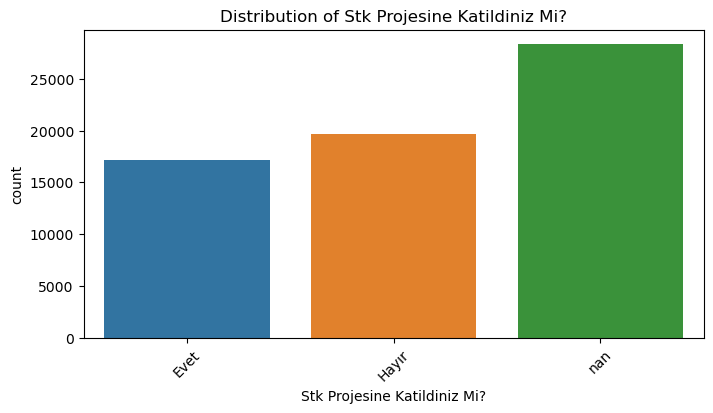

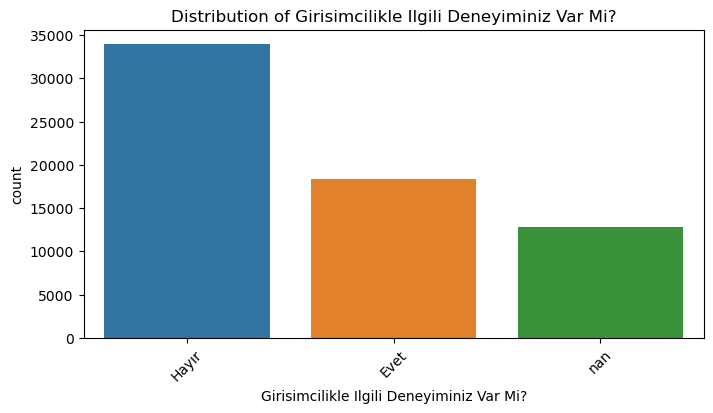

KeyboardInterrupt: 

In [39]:
# Kategorik değişkenlerin dağılımını görselleştir
for col in categorical_columns:
    plt.figure(figsize=(8,4))
    sns.countplot(data = df, x = col)
    plt.title(f"Distribution of {col}")
    plt.xticks(rotation = 45)
    plt.show()

C:\Users\ASUS\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


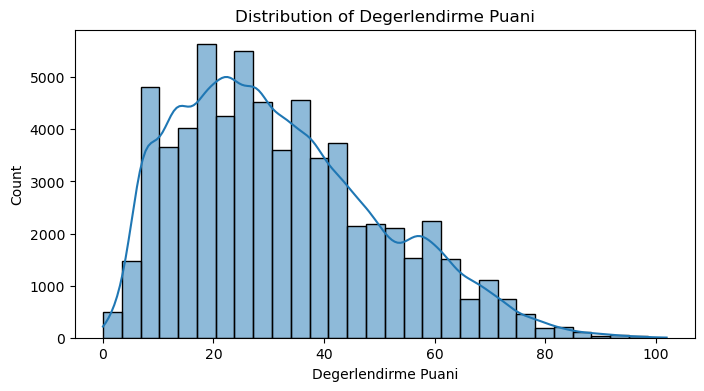

In [41]:
# Hedef değişkenin dağılımını görselleştir
plt.figure(figsize = (8,4))
sns.histplot(df["Degerlendirme Puani"], bins = 30, kde = True )
plt.title('Distribution of Degerlendirme Puani')
plt.show()

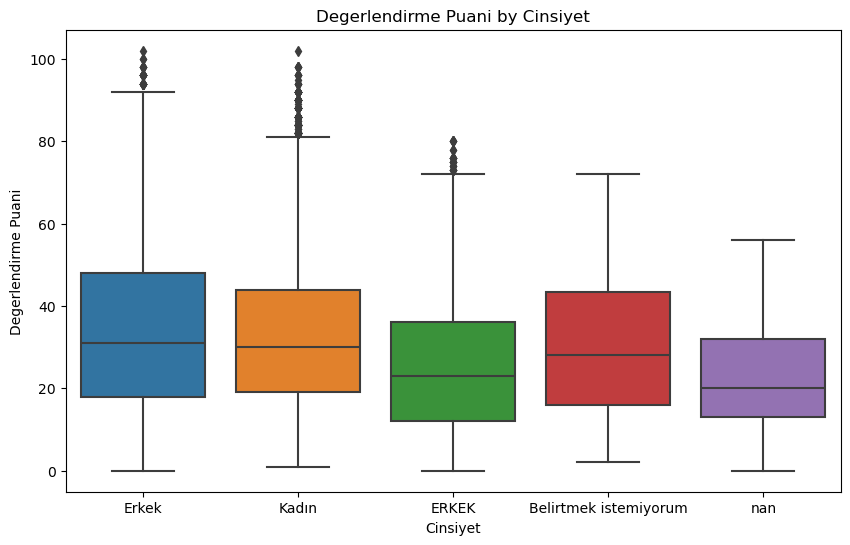

In [42]:
# Kategorik ve sayısal değişkenler arasındaki ilişkileri görselleştir
plt.figure(figsize=(10, 6))
sns.boxplot(data=df, x='Cinsiyet', y='Degerlendirme Puani')
plt.title('Degerlendirme Puani by Cinsiyet')
plt.show()

## 3. Özellik ve Hedef Değişkenlerin Ayrılması

In [44]:
# Özellik ve hedef değişkenlerin ayrılması
X = df.drop(columns=["Degerlendirme Puani", "id"])
y = df["Degerlendirme Puani"]

# Kategorik ve sayısal sütunlar
categorical_features = X.select_dtypes(include=['object']).columns
numerical_features = X.select_dtypes(exclude=['object']).columns

In [45]:
print("categorical_features", categorical_features)

print("\n numerical_features", numerical_features)

categorical_features Index(['Cinsiyet', 'Dogum Tarihi', 'Dogum Yeri', 'Ikametgah Sehri',
       'Universite Adi', 'Universite Turu', 'Burs Aliyor mu?', 'Bölüm',
       'Universite Kacinci Sinif', 'Universite Not Ortalamasi',
       'Daha Once Baska Bir Universiteden Mezun Olmus', 'Lise Adi',
       'Lise Adi Diger', 'Lise Sehir', 'Lise Turu', 'Lise Bolumu',
       'Lise Bolum Diger', 'Lise Mezuniyet Notu',
       'Baska Bir Kurumdan Burs Aliyor mu?', 'Burs Aldigi Baska Kurum',
       'Baska Kurumdan Aldigi Burs Miktari', 'Anne Egitim Durumu',
       'Anne Calisma Durumu', 'Anne Sektor', 'Baba Egitim Durumu',
       'Baba Calisma Durumu', 'Baba Sektor', 'Kardes Sayisi',
       'Girisimcilik Kulupleri Tarzi Bir Kulube Uye misiniz?',
       'Uye Oldugunuz Kulubun Ismi',
       'Profesyonel Bir Spor Daliyla Mesgul musunuz?',
       'Spor Dalindaki Rolunuz Nedir?', 'Aktif olarak bir STK üyesi misiniz?',
       'Hangi STK'nin Uyesisiniz?', 'Stk Projesine Katildiniz Mi?',
       'Girisimcilik

## 4. Veri Ön İşleme

In [47]:
# Ön işleme adımları
numerical_transformer = Pipeline(steps=[(
    'imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())
])

Bu kod parçası, veri ön işleme adımlarını düzenlemek ve uygulamak için `scikit-learn` kütüphanesinin sağladığı araçları kullanır. Burada, sayısal ve kategorik özelliklerin işlenmesi için iki ayrı işleme boru hattı (pipeline) tanımlanmıştır. Ayrıca, bu boru hatlarını bir araya getiren bir `ColumnTransformer` oluşturulmuştur. İşte her bir bileşenin detaylı açıklaması:

### 1. **Sayısal Özellikler için İşleme Boru Hattı:**

```python
numerical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())
])
```

- **`Pipeline`:** Bir dizi işleme adımını sırayla uygulamak için kullanılır. Burada `numerical_transformer` isimli bir boru hattı tanımlanmıştır.
  - **`('imputer', SimpleImputer(strategy='median'))`:** Eksik sayısal verileri doldurmak için kullanılan adım. `SimpleImputer` sınıfı, eksik değerleri belirli bir stratejiye göre doldurur.
    - `strategy='median'`: Eksik değerler sütunun medyan değeri ile doldurulur. Medyan, veri setinin ortasında bulunan değerdir ve outlier'lara karşı daha dayanıklıdır.
  - **`('scaler', StandardScaler())`:** Sayısal verileri standartlaştırmak için kullanılan adım. `StandardScaler` sınıfı, verilerin ortalamasını 0 ve standart sapmasını 1 yaparak özelliklerin ölçeklenmesini sağlar.

In [50]:
categorical_transformer = Pipeline(steps=[(
    'imputer', SimpleImputer(strategy='most_frequent')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

### 2. **Kategorik Özellikler için İşleme Boru Hattı:**

```python
categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])
```

- **`Pipeline`:** Kategorik verileri işlemek için kullanılan bir başka boru hattı.
  - **`('imputer', SimpleImputer(strategy='most_frequent'))`:** Eksik kategorik verileri doldurmak için kullanılan adım. `SimpleImputer` sınıfı, eksik değerleri en sık tekrar eden değer ile doldurur.
    - `strategy='most_frequent'`: Eksik değerler sütundaki en sık tekrar eden değer ile doldurulur.
  - **`('onehot', OneHotEncoder(handle_unknown='ignore'))`:** Kategorik verileri one-hot encoding ile dönüştürmek için kullanılan adım. `OneHotEncoder` sınıfı, her bir kategoriyi ikili (0 veya 1) sütunlara dönüştürür.
    - `handle_unknown='ignore'`: Eğitim veri setinde bulunmayan kategorilere karşılık gelen sütunlar oluşturulmaz ve bu kategoriler görmezden gelinir.

In [51]:
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numerical_transformer, numerical_features),
        ('cat', categorical_transformer, categorical_features)
    ])

### 3. **Kolon Dönüştürücü (ColumnTransformer):**

```python
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numerical_transformer, numerical_features),
        ('cat', categorical_transformer, categorical_features)
    ]
)
```

- **`ColumnTransformer`:** Bir veri setindeki farklı sütun gruplarına çeşitli ön işleme adımlarını uygulamak için kullanılır.
  - **`transformers`:** Uygulamak istediğiniz işleme adımlarını ve hangi sütunlara uygulayacağınızı belirten bir liste.
    - **`('num', numerical_transformer, numerical_features)`:** `numerical_transformer` boru hattını, `numerical_features` olarak tanımlanan sayısal sütunlara uygular.
    - **`('cat', categorical_transformer, categorical_features)`:** `categorical_transformer` boru hattını, `categorical_features` olarak tanımlanan kategorik sütunlara uygular.

## 5. Model Oluşturma ve Hiperparametre Optimizasyonu

In [ ]:
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from catboost import CatBoostRegressor
from sklearn.metrics import mean_squared_error

# CatBoost Modeli oluşturma (6 çekirdek ile)
model_catboost = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', CatBoostRegressor(verbose=0, thread_count=6))  # thread_count=6
])

# Veriyi eğitim ve test olarak ayırma
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Genişletilmiş hiperparametre ızgarası
param_dist = {
    'regressor__l2_leaf_reg': [1, 3, 7, 9],
    'regressor__subsample': [0.6, 0.8, 1.0],
    'regressor__bagging_temperature': [0.2, 0.7],
    'regressor__random_strength': [0.5, 2.0]
}

# RandomizedSearchCV ile hiperparametre optimizasyonu
random_search = RandomizedSearchCV(model_catboost, param_distributions=param_dist, 
                                   n_iter=50, scoring='neg_mean_squared_error', cv=3, 
                                   random_state=42, verbose=3)

# Modeli eğitme ve hiperparametre optimizasyonu
random_search.fit(X_train, y_train)

# En iyi hiperparametreleri göster
print("En iyi hiperparametreler: ", random_search.best_params_)

# En iyi model ile tahmin yap
best_model = random_search.best_estimator_
y_pred_catboost = best_model.predict(X_test)

# Performans değerlendirme
rmse_catboost = np.sqrt(mean_squared_error(y_test, y_pred_catboost))
print(f'Tuned CatBoost RMSE: {rmse_catboost:.4f}')

Bu kod parçası, CatBoost regresyon modeli ile veri setiniz üzerinde hiperparametre optimizasyonu yapmayı ve modelin performansını değerlendirmeyi amaçlar. İşte adım adım detaylı bir açıklama:

### 1. **Gerekli Kütüphanelerin İçe Aktarılması**

```python
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from catboost import CatBoostRegressor
from sklearn.metrics import mean_squared_error
```
- **`train_test_split`:** Veri setini eğitim ve test setlerine ayırmak için kullanılır.
- **`RandomizedSearchCV`:** Hiperparametre optimizasyonu yapmak için kullanılır. Farklı hiperparametre kombinasyonlarını denemek için rastgele arama yapar.
- **`CatBoostRegressor`:** CatBoost kütüphanesinden bir regresyon modelidir.
- **`mean_squared_error`:** Modelin tahmin performansını değerlendirmek için kullanılan bir metriktir (ortalama kare hata).

### 2. **CatBoost Modeli Oluşturma**

```python
model_catboost = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', CatBoostRegressor(verbose=0, thread_count=6))  # thread_count=6
])
```
- **`Pipeline`:** Ön işleme adımları ve modelin bir araya getirilmesini sağlar. Burada iki aşamalı bir boru hattı oluşturulmuştur.
  - **`('preprocessor', preprocessor)`:** Daha önce tanımladığınız `preprocessor` adında bir `ColumnTransformer` nesnesini içerir. Bu, veri ön işleme adımlarını uygular.
  - **`('regressor', CatBoostRegressor(verbose=0, thread_count=6))`:** CatBoost regresyon modelini tanımlar. `verbose=0` modeli çalıştırırken herhangi bir bilgi mesajı göstermemek için kullanılır. `thread_count=6`, modelin 6 çekirdekte çalışmasını sağlar.

### 3. **Veriyi Eğitim ve Test Olarak Ayırma**

```python
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
```
- **`train_test_split`:** Veri setini eğitim (`X_train`, `y_train`) ve test (`X_test`, `y_test`) setlerine böler.
  - **`X` ve `y`:** Özellikler ve hedef değişkenlerin bulunduğu veri setleri.
  - **`test_size=0.2`:** Veri setinin %20'sinin test seti olarak ayrılacağını belirtir.
  - **`random_state=42`:** Sonuçların tekrarlanabilir olması için rastgeleliği kontrol eder.

### 4. **Genişletilmiş Hiperparametre Izgarası**

```python
param_dist = {
    'regressor__l2_leaf_reg': [1, 3, 7, 9],
    'regressor__subsample': [0.6, 0.8, 1.0],
    'regressor__bagging_temperature': [0.2, 0.7],
    'regressor__random_strength': [0.5, 2.0]
}
```
- **`param_dist`:** `RandomizedSearchCV` için denenecek hiperparametrelerin aralıklarını belirler. Burada dört hiperparametre için olası değerler tanımlanmıştır:
  - **`l2_leaf_reg`:** L2 düzenleme parametresi.
  - **`subsample`:** Eğitim verisinin rastgele bir alt kümesinin kullanılması oranı.
  - **`bagging_temperature`:** Bagging (örnekleme) sıcaklığı.
  - **`random_strength`:** Rastgelelik gücü.

### 5. **RandomizedSearchCV ile Hiperparametre Optimizasyonu**

```python
random_search = RandomizedSearchCV(model_catboost, param_distributions=param_dist, 
                                   n_iter=50, scoring='neg_mean_squared_error', cv=3, 
                                   random_state=42, verbose=3)
```
- **`RandomizedSearchCV`:** Belirli hiperparametrelerin kombinasyonlarını rastgele seçerek modelin en iyi hiperparametrelerini bulur.
  - **`model_catboost`:** Optimizasyon yapılacak model.
  - **`param_distributions=param_dist`:** Hiperparametrelerin aralıklarını belirtir.
  - **`n_iter=50`:** Rastgele arama sırasında denenecek hiperparametre kombinasyonlarının sayısı.
  - **`scoring='neg_mean_squared_error'`:** Modelin performansını değerlendirmek için negatif ortalama kare hata kullanılır. `neg_mean_squared_error`, daha düşük değerler daha iyi performansı gösterir.
  - **`cv=3`:** 3 katlamalı çapraz doğrulama (cross-validation) kullanılır.
  - **`random_state=42`:** Sonuçların tekrarlanabilir olması için rastgeleliği kontrol eder.
  - **`verbose=3`:** Arama sürecinde bilgi mesajları gösterir.

### 6. **Modeli Eğitme ve Hiperparametre Optimizasyonu**

```python
random_search.fit(X_train, y_train)
```
- **`fit`:** Modeli eğitim verileri (`X_train`, `y_train`) üzerinde eğitir ve hiperparametre optimizasyonunu gerçekleştirir.

### 7. **En İyi Hiperparametreleri Gösterme**

```python
print("En iyi hiperparametreler: ", random_search.best_params_)
```
- **`best_params_`:** En iyi performansı gösteren hiperparametre kombinasyonlarını döndürür.

### 8. **En İyi Model ile Tahmin Yapma**

```python
best_model = random_search.best_estimator_
y_pred_catboost = best_model.predict(X_test)
```
- **`best_estimator_`:** En iyi hiperparametrelerle eğitilmiş model.
- **`predict`:** Test verileri (`X_test`) üzerinde tahmin yapar.

### 9. **Performans Değerlendirme**

```python
rmse_catboost = np.sqrt(mean_squared_error(y_test, y_pred_catboost))
print(f'Tuned CatBoost RMSE: {rmse_catboost:.4f}')
```
- **`mean_squared_error(y_test, y_pred_catboost)`:** Test verileri ile tahminler arasındaki ortalama kare hatayı hesaplar.
- **`np.sqrt`:** Ortalama kare hatanın karekökünü alır. Bu, kök ortalama kare hata (RMSE) metriğini verir.
- **`print`:** RMSE değerini ekrana yazdırır. RMSE, modelin tahminlerinin ne kadar iyi olduğunu gösterir; daha düşük RMSE daha iyi performansı temsil eder.

Bu kod, CatBoost regresyon modeli ile veri setiniz üzerinde hiperparametre optimizasyonu yapar ve modelin performansını değerlendirir.

## 6. Test Verisinin Ön İşlenmesi ve Tahmin

In [ ]:
# Test veri setinde eksik sütunları kontrol etme
missing_columns = set(X.columns) - set(test_df.columns)
if missing_columns:
    print(f"Test veri setinde eksik sütunlar: {missing_columns}")

# Test veri setini ön işleme
test_df = test_df[X.columns.intersection(test_df.columns)]
test_df.fillna(df.mode().iloc[0], inplace=True)

# Test verisine tahmin uygulama
y_pred_test = best_model.predict(test_df)

# Tahmin sonuçlarını kaydetme
submission = pd.DataFrame({
    'id': test_df.index,
    'Degerlendirme Puani': y_pred_test
})

submission.to_csv("submission.csv", index=False)

print("Submission dosyası oluşturuldu.")

Bu kod, test veri setini (muhtemelen modelin hiç görmediği verileri) işlemeye, eksik sütunları kontrol etmeye, test verisi üzerinde tahmin yapmaya ve sonuçları CSV formatında kaydetmeye yönelik adımları içerir. Aşağıda adım adım detaylı bir açıklama yer alıyor:

### 1. **Test Veri Setinde Eksik Sütunları Kontrol Etme**

```python
missing_columns = set(X.columns) - set(test_df.columns)
if missing_columns:
    print(f"Test veri setinde eksik sütunlar: {missing_columns}")
```

- **`X.columns`:** Eğitim setindeki (modelin eğitildiği veri seti) sütun isimlerini alır.
- **`test_df.columns`:** Test veri setindeki sütun isimlerini alır.
- **`set(X.columns) - set(test_df.columns)`:** Eğitim setindeki sütunlardan test veri setinde olmayanları bulur. Bu işlemin amacı, test veri setinde eksik sütun olup olmadığını kontrol etmektir.
- **`missing_columns`:** Test veri setinde eksik olan sütunları tutar. Eğer bu set boş değilse, eksik sütunlar ekrana yazdırılır.
- **Sonuç:** Eğer test veri setinde eğitim setinde olup eksik olan sütunlar varsa, kullanıcıya bu eksik sütunların hangileri olduğu bildirilir.

### 2. **Test Veri Setini Ön İşleme**

```python
test_df = test_df[X.columns.intersection(test_df.columns)]
test_df.fillna(df.mode().iloc[0], inplace=True)
```

- **`X.columns.intersection(test_df.columns)`:** Eğitim setindeki ve test setindeki ortak sütunları alır. Bu işlem, sadece her iki veri setinde de bulunan sütunları test veri setine dahil eder. Bu, eksik sütunlar varsa onların test setinde göz ardı edilmesini sağlar.
- **`fillna(df.mode().iloc[0], inplace=True)`:** Eksik verileri doldurur. Burada, her bir sütunun en sık görülen değeri (modu) ile eksik değerler dolduruluyor. Bu adım, eksik verilerle başa çıkmak için kullanılır.

### 3. **Test Verisine Tahmin Uygulama**

```python
y_pred_test = best_model.predict(test_df)
```

- **`best_model`:** Daha önce hiperparametre optimizasyonu yapılarak eğitilmiş ve en iyi performansı gösteren modeldir.
- **`predict(test_df)`:** Model, işlenmiş test veri seti üzerinde tahminler yapar. Bu tahminler hedef değişkenin (muhtemelen 'Değerlendirme Puanı' gibi) değerlerini içerir.
- **`y_pred_test`:** Test veri seti için yapılan tahminleri tutar.

### 4. **Tahmin Sonuçlarını Kaydetme**

```python
submission = pd.DataFrame({
    'id': test_df.index,
    'Degerlendirme Puani': y_pred_test
})
```

- **`pd.DataFrame`:** Pandas DataFrame oluşturur. Bu, tahmin sonuçlarını CSV dosyasına kaydetmek için kullanılır.
  - **`'id': test_df.index`:** Test veri setindeki her bir gözlemin indeksi, 'id' sütunu olarak tanımlanır. Bu, genellikle test veri setinde bulunan bir kimlik veya sıra numarasıdır.
  - **`'Degerlendirme Puani': y_pred_test`:** Modelin test seti üzerinde yaptığı tahminler bu sütunda tutulur.

### 5. **Tahmin Sonuçlarını CSV Dosyasına Kaydetme**

```python
submission.to_csv("submission.csv", index=False)
```

- **`to_csv`:** DataFrame’i CSV dosyasına kaydetmek için kullanılır. 
- **`"submission.csv"`:** Dosyanın adı belirlenir.
- **`index=False`:** İndeksi CSV dosyasına dahil etmez (çünkü indeksin zaten 'id' sütunu olarak dahil edildiği varsayılır).

### 6. **Dosya Oluşturuldu Mesajı**

```python
print("Submission dosyası oluşturuldu.")
```

- Sonuç olarak, model tarafından test veri setine uygulanan tahminler "submission.csv" dosyasına yazdırılır ve bu dosyanın oluşturulduğu bildirilir.

### Genel Anlam

Bu kodun amacı, test veri setindeki eksik sütunları kontrol etmek, veriyi işleyip model üzerinde tahminler yapmak ve bu tahminleri bir CSV dosyasına kaydetmektir. Özellikle yarışmalarda veya projelerde, tahmin sonuçlarının değerlendirilmesi için genellikle bu tür dosyalar gereklidir.